In [2]:
import pandas as pd
import geopandas as gpd
import numpy as np

In [3]:
# dataset = pd.read_pickle('../../geodata/results/01_master_building_dataset.pkl')
dataset = pd.read_pickle('../../../geodata/results/01_master_building_dataset.pkl')


In [4]:
maxvsh_cols    = dataset.columns[dataset.columns.str.contains('maxvsh')].tolist()
vaccess_cols   = dataset.columns[dataset.columns.str.contains('vwa')].tolist()
# mean_cols      = dataset.columns[dataset.columns.str.contains('mn')].tolist()
dist_cols      = dataset.columns[dataset.columns.str.contains('sum_')].tolist()
vconfig_cols   = np.setdiff1d(dataset.columns[np.where(dataset.columns == 'snt_0')[0][0]:np.where(dataset.columns == 'cmpx_gini')[0][0]+1].tolist(),dist_cols).tolist()
id_cols        = ['ID_Geb','Stockwerk','FassPktX','FassPktY','FassPktZ']

dataset['unit_pano'] = dataset['unit_pano'].fillna(0)



In [5]:
import joblib
xgb_model   = joblib.load("../../../geodata/results/t10agglo_models/tr292ts73_XGB.joblib")
model_feats    = maxvsh_cols+vaccess_cols+vconfig_cols+dist_cols

scaler_4model   = joblib.load("../../../geodata/results/scaler_for_model.joblib")

X = dataset.copy()
X[model_feats] = scaler_4model.transform(dataset[model_feats])

X['XGB'] = xgb_model.predict(X[xgb_model.feature_names_in_])
X = X.reset_index()


[23:07:12] WARNING: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-10.9-x86_64-cpython-38/xgboost/src/learner.cc:553: 
  If you are loading a serialized model (like pickle in Python, RDS in R) generated by
  older XGBoost, please export the model by calling `Booster.save_model` from that version
  first, then load it back in current version. See:

    https://xgboost.readthedocs.io/en/latest/tutorials/saving_model.html

  for more details about differences between saving model and serializing.



/Users/adamswietek/opt/anaconda3/envs/env_intel_sdb/lib/python3.10/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator MinMaxScaler from version 1.2.1 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [7]:
ch_hexbin = gpd.read_file('../../../geodata/ch_terrain/ch_slope_2056.gpkg').reset_index()
ch_hexbin.rename(columns = {'index':'hexbin_id','_median':'slope_median', '_mean':'slope_mean'}, inplace = True)


In [8]:
X = gpd.sjoin(ch_hexbin[['hexbin_id', 'slope_mean','slope_median','geometry']],X,how='right')

In [5]:
X.to_pickle('../../../geodata/results/02_spatial_binned_master.pkl')
# dataset = pd.read_pickle('../../../geodata/results/02_spatial_binned_master.pkl')

In [6]:
import mapclassify as mc
import geopandas as gpd


In [8]:
grp = dataset.groupby('Agglo_Name')[maxvsh_cols]

scarce_maxvsh = np.array(maxvsh_cols)[~(grp.median()>0).all()]
abund_maxvsh = np.array(maxvsh_cols)[(grp.median()>0).all()]

In [9]:
# assign building resid terms and bin true incomes 
dataset = dataset.assign(pred = dataset.XGB) # define predictions to use
dataset = dataset.assign(resid = np.log(dataset.pred/dataset.net_income_ptp)) # absolute error of logs
dataset['l_avg'] = dataset.groupby('Agglo_Name')['pred'].transform('mean') # define agglo-level mean prediction
dataset['l_prob'] = (dataset['pred']>dataset['l_avg']) # T/F whether bldg is greater than agglo mean prediction

def getZ(x):
    return ((x-x.mean())/x.std())

dataset['z_resid'] = getZ(dataset.resid) # standardize residuals

In [10]:
import geopandas as gpd
import quantecon as qe
from scipy import stats
import numpy as np

def aggVC(df, grpby_lst):
    # wrt CHF 100k
    threshold = 100
    gdf_hxbn = (df.groupby(grpby_lst)['pred']
            .agg(count   = lambda x: len(x),
                 rich    = lambda x: sum( x > threshold),
                 prob    = lambda x: np.mean( x > threshold),
                 cv      = lambda x: stats.variation(x),
                 gini    = lambda x: qe.gini_coefficient(x.values),
                 med     = lambda x: np.median(x),
                 avg     = lambda x: np.mean(x),
                 ))
    return gdf_hxbn

def aggLocal(df,grpby_lst):
    # wrt agglo mean
    return (df.groupby(grpby_lst)['l_prob'].mean())

def aggIncome(df,grpby_lst):
    return (df.groupby(grpby_lst)[['net_income_ptp','z_resid']].mean())

def aggNaturalForm(df, grpby_lst):
    return (df.groupby(grpby_lst)[['slope_median','slope_mean']].mean())
    #slope mean, median

def aggViewMetrics(df, grpby_lst):
    # vconfig at median
    m1 = df.groupby(grpby_lst)[vconfig_cols].median()
    # vcomp abundance at median
    m2 = df.groupby(grpby_lst)[abund_maxvsh].median()
    # vcomp scarce as proportion of blgs with 1% view
    m3 = df.groupby(grpby_lst)[scarce_maxvsh].apply(lambda x: np.mean(x > 1).round(2)).add_suffix('_1')
    # vcomp scarce as proportion of blgs with 10% view
    m4 = df.groupby(grpby_lst)[scarce_maxvsh].apply(lambda x: np.mean(x > 10).round(2)).add_suffix('_10')
    return pd.concat([m1, m2, m3, m4], axis = 1)

def aggTO(df, grpby_lst):
    m1 = aggVC(df, grpby_lst)#.reset_index().set_index(grpby_lst[1])
    m2 = aggLocal(df, grpby_lst)#.reset_index().set_index(grpby_lst[1])
    m3 = aggIncome(df, grpby_lst)#.reset_index().set_index(grpby_lst[1])
    m4 = aggNaturalForm(df, grpby_lst)#.reset_index().set_index(grpby_lst[1])
    m5 = aggViewMetrics(df, grpby_lst)#.reset_index().set_index(grpby_lst[1])
    return pd.concat([m1, m2, m3, m4, m5], axis = 1)

In [11]:
ch_income = gpd.read_file('../../../geodata/ch_districts/ch_income_per_commune_2018.gpkg')
# commune_incomes = (ch_income.query('net_income_ptp < 400000').net_income_ptp.dropna())/1000 # set income in CHF 1000k
# income_bins = mc.HeadTailBreaks(commune_incomes).bins # set income bins
# dataset['income_bin'] = pd.cut(dataset.net_income_ptp, bins = income_bins.round(0)) # define income bins


In [12]:
gdf_commune = aggTO(dataset, ['GMDNAME'])
gdf_commune = pd.merge(gdf_commune.reset_index(),#.drop(columns = ['slope_mean','slope_median']), 
                    ch_income[['GMDNAME','geometry']],# 'slope_mean','slope_median',
                    left_on='GMDNAME', 
                    right_on= 'GMDNAME', 
                    how='right')
gdf_commune = gpd.GeoDataFrame(gdf_commune, geometry= gdf_commune.geometry , crs = 2056)

/Users/adamswietek/opt/anaconda3/envs/env_intel_sdb/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3462: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/Users/adamswietek/opt/anaconda3/envs/env_intel_sdb/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3462: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/Users/adamswietek/opt/anaconda3/envs/env_intel_sdb/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3462: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0

In [13]:
ch_hexbin = gpd.read_file('../../../geodata/ch_terrain/ch_slope_2056.gpkg').reset_index()
ch_hexbin.rename(columns = {'index':'hexbin_id','_median':'slope_median', '_mean':'slope_mean'}, inplace = True)

In [14]:
gdf_hexbin = aggTO(dataset, ['hexbin_id'])
gdf_hexbin = pd.merge(gdf_hexbin.reset_index(),#.drop(columns = ['slope_mean','slope_median']), 
                    ch_hexbin[['hexbin_id','geometry']],# 'slope_mean','slope_median',
                    left_on='hexbin_id', 
                    right_on= 'hexbin_id', 
                    how='right')
gdf_hexbin = gpd.GeoDataFrame(gdf_hexbin, geometry= gdf_hexbin.geometry , crs = 2056)

/Users/adamswietek/opt/anaconda3/envs/env_intel_sdb/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3462: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/Users/adamswietek/opt/anaconda3/envs/env_intel_sdb/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3462: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/Users/adamswietek/opt/anaconda3/envs/env_intel_sdb/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3462: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0

In [15]:
gdf_hexbin.to_pickle('../../../geodata/results/04_vm_hexbin.pkl')
gdf_commune.to_pickle('../../../geodata/results/04_vm_commune.pkl')

<Axes: >

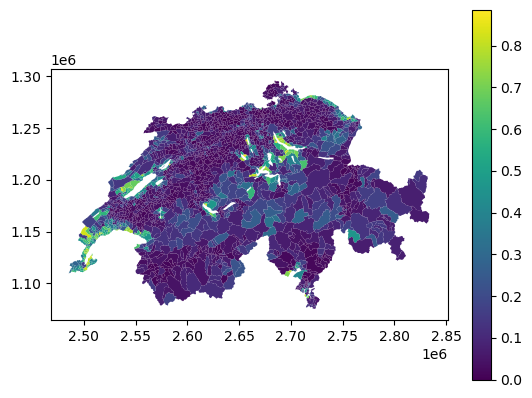

In [34]:
gdf_commune.plot(column = 'prob', legend = True)

<Axes: >

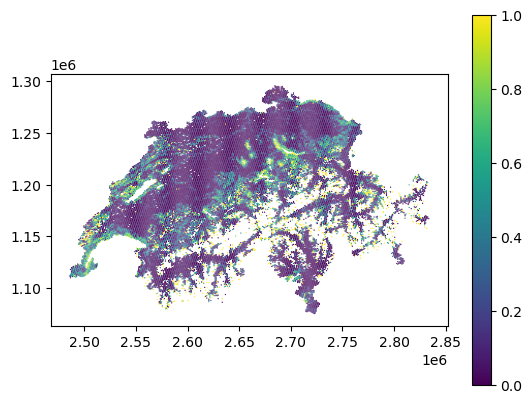

In [33]:
gdf_hexbin.plot(column = 'prob', legend = True)